In [25]:
import pickle
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from NonnegMFPy import nmf
from sklearn.decomposition import NMF
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import fnmatch
import cv2
import random
from random import seed

In [2]:
feature_11 = pickle.load(open( "11", "rb" ))
feature_8 = pickle.load(open( "8", "rb" ))
feature_19 = pickle.load(open( "19", "rb" )) #Chinese
feature_67 = pickle.load(open( "67", "rb" )) #Chinese

In [3]:
df_8 = pd.DataFrame.from_dict(feature_8, orient='index', columns=['data_array', 'word'])
df_11 = pd.DataFrame.from_dict(feature_11, orient='index', columns=['data_array', 'word'])
df_19 = pd.DataFrame.from_dict(feature_19, orient='index', columns=['data_array', 'word'])
df_67 = pd.DataFrame.from_dict(feature_67, orient='index', columns=['data_array', 'word'])
# +1 to avoid 0 in Seq NMF.
df2_8 = pd.DataFrame(df_8['data_array'].to_list()).set_index(df_8.index)+1 
df2_11 = pd.DataFrame(df_11['data_array'].to_list()).set_index(df_11.index)+1
df2_19 = pd.DataFrame(df_19['data_array'].to_list()).set_index(df_19.index)+1
df2_67 = pd.DataFrame(df_67['data_array'].to_list()).set_index(df_67.index)+1

df_8_11 = pd.concat([df2_8, df2_11]) 
df_19_67 = pd.concat([df2_19, df2_67]) 
df_all =  pd.concat([df2_8, df2_11, df2_19, df2_67])

In [4]:
def NMFcomponents(ref, n_components = None, maxiters = 1e3, oneByOne = False):
    """ref and ref_err should be (n * height * width) where n is the number of references. Mask is the region we are interested in.
    if mask is a 3D array (binary, 0 and 1), then you can mask out different regions in the ref.
    if path_save is provided, then the code will star from there.
    """

    if not oneByOne:
      print("Building components NOT one by one... If you want the one-by-one method, please set oneByOne = True.")
      component = NMF(n_components=n_components, init='random', random_state=0)
      W = component.fit_transform(ref)
      H = component.components_
      return W, H 
    else:
        print("Building components one by one...")
        for i in range(n_components):
            print("\t" + str(i+1) + " of " + str(n_components))
            n = i + 1
            if (i == 0):
                component = nmf.NMF(ref, n_components= n)
            else:
                W_ini = np.random.rand(ref.shape[0], n)
                W_ini[:, :(n-1)] = np.copy(component.W)
                # W_ini = np.array(W_ini, order = 'F') #Fortran ordering, column elements contiguous in memory.
        
                H_ini = np.random.rand(n, ref.shape[1])
                H_ini[:(n-1), :] = np.copy(component.H)
                # H_ini = np.array(H_ini, order = 'C') #C ordering, row elements contiguous in memory.
        
                component = nmf.NMF(ref, W = W_ini, H = H_ini, n_components= n)
            chi2 = component.SolveNMF(maxiters=maxiters)
         
    return component

In [83]:
def PCA_cluster_num(df):
    normalized_df=(df-df.mean())
    cov_matrix = np.dot(normalized_df.T, normalized_df) / normalized_df.shape[0]
    pca = PCA(n_components=20)
    pca.fit(normalized_df)
    i = 0
    for eigenvector in pca.components_:
        eigenvalue = np.dot(eigenvector.T, np.dot(cov_matrix, eigenvector))
        print(i, "th eigenvalue is: ", eigenvalue)
        if eigenvalue < 1:
            print("---------------------------------")
            print('Number of clusters: ', i)
            break
        i += 1
    return i

In [123]:
def Seq_NMF(cluster_num, df):
    nmf_comp = NMFcomponents(df,cluster_num, oneByOne = True)
    W = nmf_comp.W
    H = nmf_comp.H
    df_W = pd.DataFrame(W, columns = [str(i+1) for i in range(cluster_num)]).set_index(df.index)
    clustering_df = pd.DataFrame(df_W.idxmax(axis = 1, skipna = True))
    clustering_df.columns = ['cluster']
    return clustering_df

In [59]:
def print_cluster(clustering_df, cluster_num, print_all= True, cluster_lst = None, print = True):
    cluster_dict = {}
    if print_all:
        for i in range(cluster_num):
            if print:
                print("Cluster ", i+1)
                print(clustering_df[clustering_df['cluster'] == str(i+1)].index.tolist())
            cluster_dict[i+1] = clustering_df[clustering_df['cluster'] == str(i+1)].index.tolist()
    else:
        for i in cluster_lst:
            if print:
                print("Cluster ", i)
                print(clustering_df[clustering_df['cluster'] == str(i)].index.tolist())   
            cluster_dict[i] = clustering_df[clustering_df['cluster'] == str(i+1)].index.tolist()
    return cluster_dict

In [79]:
def print_cluster_image(filePath, cluster_dict, cluster_num):
    file_dict_raw = {}
    seed(1)
    for i in range(cluster_num):
        #print('Cluster ', i+1)
        #show_lst = cluster_dict[i+1][:6]
        random.shuffle(cluster_dict[i+1])
        show_lst = cluster_dict[i+1][:6]
        show_lst = [i[0]+'_'+str(i[1])+'_*.png' for i in show_lst]
        file_dict_raw[i+1] = show_lst

    file_dict = {}
    for i in range(cluster_num):
        file_dict[i+1] = []
        for show_lst_file in file_dict_raw[i+1]:
            for filename in os.listdir(filePath):
                if fnmatch.fnmatch(filename, show_lst_file):
                    file_name = filePath+'/'+filename
                    file_dict[i+1].append(file_name)
                    
    for i in range(cluster_num):
        if len(file_dict[i+1]) >=6:  
            figure_num = 6
        else:  
            figure_num = len(file_dict[i+1])
        # create figure
        fig = plt.figure(figsize=(15, 7))
        # setting values to rows and column variables
        rows = 2
        columns = 3
        # reading images
        image_name_lst = ['Image'+str(i+1) for i in range(figure_num)]
        #[Image1,Image2,Image3,Image4,Image5,Image6]
        image_name_lst = [cv2.imread(f) for f in file_dict[i+1]]
        #print(image_name_lst)
        for j in range(figure_num):    
            fig.add_subplot(rows, columns, j+1)
            plt.imshow(image_name_lst[j])
            plt.axis('off')
            title = 'Cluster', i+1, file_dict[i+1][j].split('/')[-1][:-4]
            plt.title(title)
        #print('---------------------------------------------------')

    return file_dict

PCA to find the number of components then perform Seq NMF.

## Analyze each video individually

### Video 8

In [11]:
cluster_num_8 = PCA_cluster_num(df2_8)
clustering_df_8 = Seq_NMF(cluster_num_8, df2_8, print_cluster = True)

0 th eigenvalue is:  19.117040761058618
1 th eigenvalue is:  7.16873004969539
2 th eigenvalue is:  4.812233076652298
3 th eigenvalue is:  3.892389103332817
4 th eigenvalue is:  3.508828078395735
5 th eigenvalue is:  2.667503139710282
6 th eigenvalue is:  2.0395134571545195
7 th eigenvalue is:  1.3072619427366678
8 th eigenvalue is:  1.2280865500959957
9 th eigenvalue is:  0.9966743265246036
---------------------------------
Number of clusters:  10
For Video 8(English), number of cluster is 9
Building components one by one...
	1 of 9
Current Chi2=0.0136, Previous Chi2=1.6831, Change=99.1925% @ niters=0
Took 0.008 minutes to reach current solution.
	2 of 9
Current Chi2=0.0180, Previous Chi2=0.1219, Change=85.2560% @ niters=0
Current Chi2=0.0142, Previous Chi2=0.0143, Change=0.2710% @ niters=20
Current Chi2=0.0138, Previous Chi2=0.0138, Change=0.0850% @ niters=40
Current Chi2=0.0136, Previous Chi2=0.0136, Change=0.0796% @ niters=60
Current Chi2=0.0133, Previous Chi2=0.0133, Change=0.2111%

Current Chi2=0.0064, Previous Chi2=0.0064, Change=0.0023% @ niters=920
Current Chi2=0.0064, Previous Chi2=0.0064, Change=0.0024% @ niters=940
Current Chi2=0.0064, Previous Chi2=0.0064, Change=0.0024% @ niters=960
Current Chi2=0.0064, Previous Chi2=0.0064, Change=0.0024% @ niters=980
Iteration in re-initialization reaches maximum number = 1000
Took 1.746 minutes to reach current solution.
	5 of 9
Current Chi2=0.0108, Previous Chi2=0.1199, Change=90.9674% @ niters=0
Current Chi2=0.0071, Previous Chi2=0.0071, Change=0.5437% @ niters=20
Current Chi2=0.0067, Previous Chi2=0.0067, Change=0.1509% @ niters=40
Current Chi2=0.0066, Previous Chi2=0.0066, Change=0.0664% @ niters=60
Current Chi2=0.0065, Previous Chi2=0.0065, Change=0.0376% @ niters=80
Current Chi2=0.0065, Previous Chi2=0.0065, Change=0.0258% @ niters=100
Current Chi2=0.0064, Previous Chi2=0.0064, Change=0.0210% @ niters=120
Current Chi2=0.0064, Previous Chi2=0.0064, Change=0.0206% @ niters=140
Current Chi2=0.0064, Previous Chi2=0.0

Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0577% @ niters=280
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0652% @ niters=300
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0671% @ niters=320
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0631% @ niters=340
Current Chi2=0.0041, Previous Chi2=0.0041, Change=0.0556% @ niters=360
Current Chi2=0.0041, Previous Chi2=0.0041, Change=0.0473% @ niters=380
Current Chi2=0.0040, Previous Chi2=0.0040, Change=0.0397% @ niters=400
Current Chi2=0.0040, Previous Chi2=0.0040, Change=0.0332% @ niters=420
Current Chi2=0.0040, Previous Chi2=0.0040, Change=0.0280% @ niters=440
Current Chi2=0.0040, Previous Chi2=0.0040, Change=0.0237% @ niters=460
Current Chi2=0.0040, Previous Chi2=0.0040, Change=0.0201% @ niters=480
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0170% @ niters=500
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0144% @ niters=520
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0122% @ niters=540
Curren

Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0104% @ niters=540
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0091% @ niters=560
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0080% @ niters=580
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0071% @ niters=600
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0063% @ niters=620
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0056% @ niters=640
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0049% @ niters=660
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0044% @ niters=680
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0039% @ niters=700
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0035% @ niters=720
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0031% @ niters=740
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0028% @ niters=760
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0026% @ niters=780
Current Chi2=0.0031, Previous Chi2=0.0031, Change=0.0023% @ niters=800
Curren

[('8', 119), ('8', 122), ('8', 125), ('8', 130), ('8', 148), ('8', 163), ('8', 214), ('8', 217), ('8', 220), ('8', 222), ('8', 223), ('8', 225), ('8', 299), ('8', 339), ('8', 342), ('8', 344), ('8', 349), ('8', 355), ('8', 360), ('8', 363), ('8', 365), ('8', 373), ('8', 381), ('8', 384), ('8', 390), ('8', 394), ('8', 397), ('8', 399), ('8', 404), ('8', 409), ('8', 434), ('8', 461), ('8', 464), ('8', 472), ('8', 482), ('8', 490), ('8', 495), ('8', 497), ('8', 500), ('8', 502), ('8', 504), ('8', 509), ('8', 518), ('8', 527), ('8', 529), ('8', 531), ('8', 533), ('8', 534), ('8', 586), ('8', 589), ('8', 592), ('8', 596), ('8', 601), ('8', 603), ('8', 606), ('8', 609), ('8', 616), ('8', 623), ('8', 630), ('8', 637), ('8', 666), ('8', 668), ('8', 677), ('8', 686), ('8', 688), ('8', 691), ('8', 695), ('8', 699), ('8', 704), ('8', 731), ('8', 756), ('8', 758), ('8', 945), ('8', 951), ('8', 1234), ('8', 1746), ('8', 1749), ('8', 1752), ('8', 1755), ('8', 2707), ('8', 2708), ('8', 2711), ('8', 2

In [81]:
print("For Video 8(English), number of cluster is", cluster_num_8)

For Video 8(English), number of cluster is 9


In [60]:
cluster_dict_8 = print_cluster(clustering_df_8, cluster_num_8, print_all= True, cluster_lst = None, print = False)

Populating the interactive namespace from numpy and matplotlib


{1: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_1152_lisa.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_1279_this.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_4729_into.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_1949_and.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_925_comes.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_1323_they.png'],
 2: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_1650_for.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_767_a.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/englis

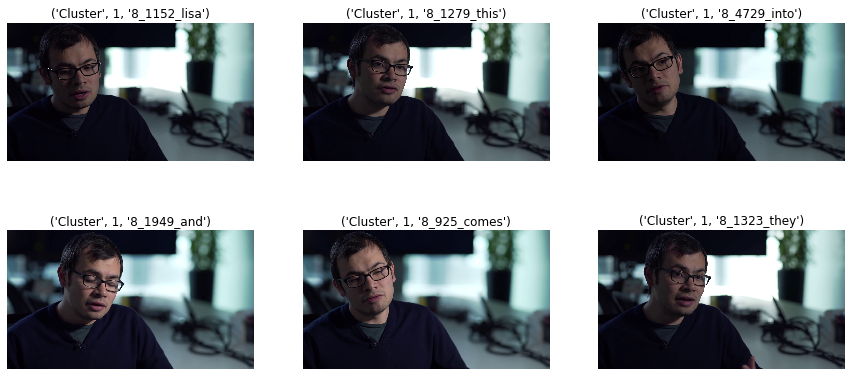

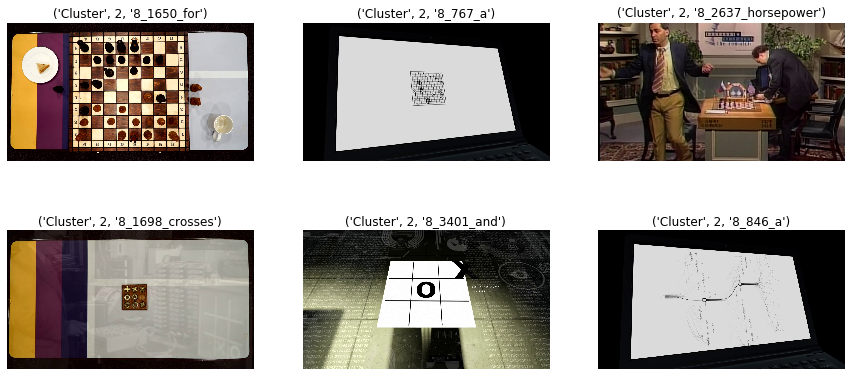

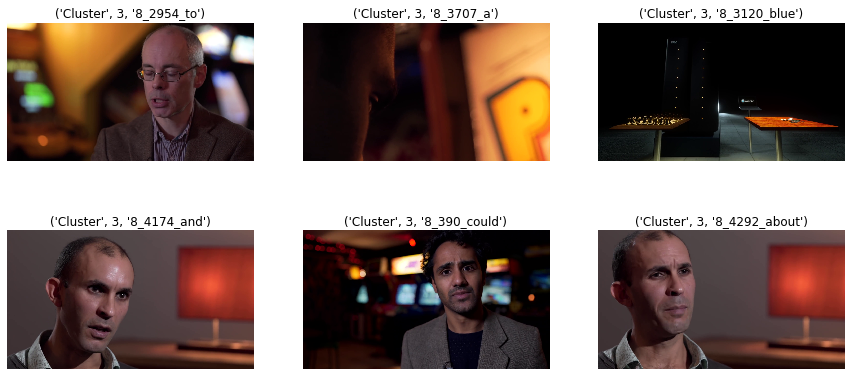

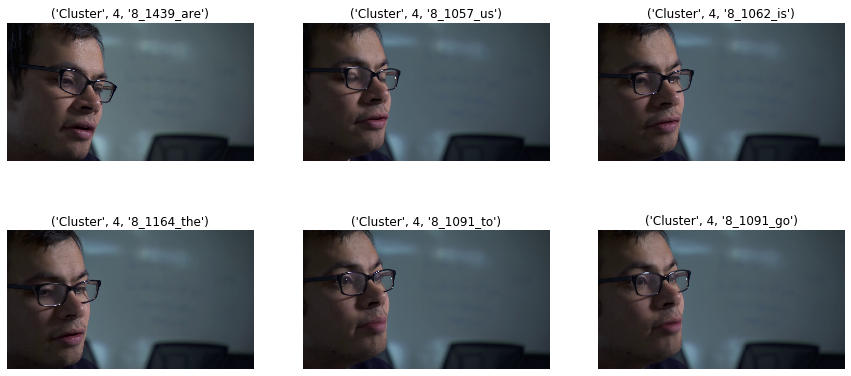

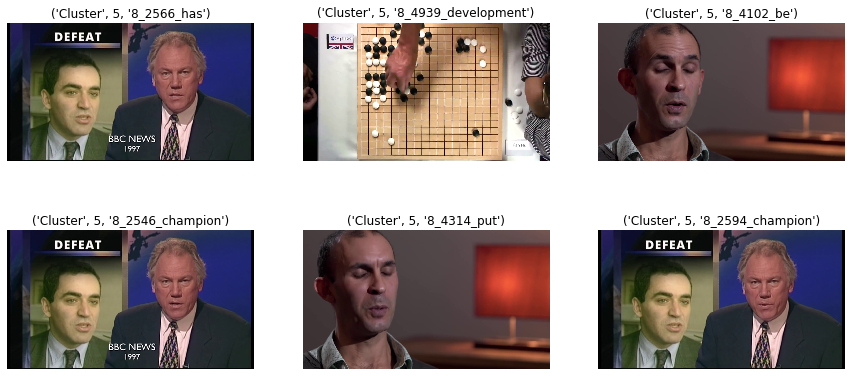

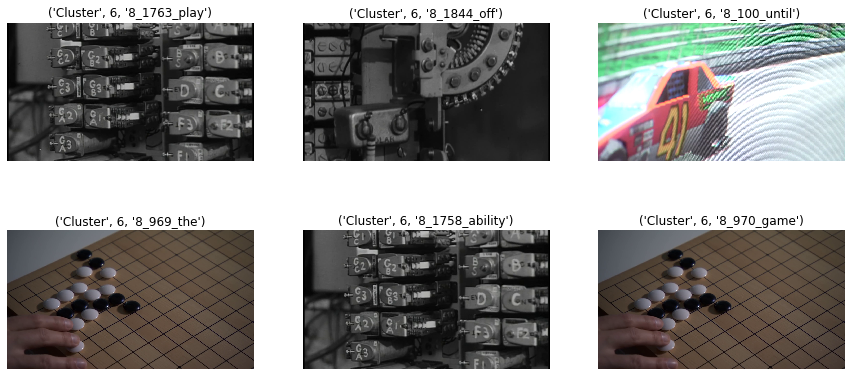

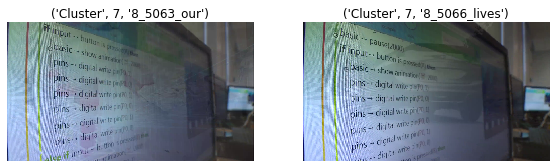

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

In [80]:
%pylab inline

filePath_8 = '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames'
print_cluster_image(filePath_8, cluster_dict_8, cluster_num_8)

### Video 11

In [84]:
cluster_num_11 = PCA_cluster_num(df2_11)
clustering_df_11 = Seq_NMF(cluster_num_11, df2_11, print_cluster = True)

0 th eigenvalue is:  17.95299878097758
1 th eigenvalue is:  9.03007726522852
2 th eigenvalue is:  7.272480729731027
3 th eigenvalue is:  4.7602106602129295
4 th eigenvalue is:  4.027580966005854
5 th eigenvalue is:  3.1945455508594662
6 th eigenvalue is:  2.9379927061298856
7 th eigenvalue is:  2.4634276756601254
8 th eigenvalue is:  2.1160251335402007
9 th eigenvalue is:  1.8191596192160913
10 th eigenvalue is:  1.5905328131388905
11 th eigenvalue is:  0.9286627442292488
---------------------------------
Number of clusters:  11
Building components one by one...
	1 of 11
Current Chi2=0.0160, Previous Chi2=1.7868, Change=99.1043% @ niters=0
Took 0.002 minutes to reach current solution.
	2 of 11
Current Chi2=0.0203, Previous Chi2=0.1180, Change=82.7845% @ niters=0
Current Chi2=0.0166, Previous Chi2=0.0167, Change=0.2330% @ niters=20
Current Chi2=0.0162, Previous Chi2=0.0162, Change=0.0754% @ niters=40
Current Chi2=0.0160, Previous Chi2=0.0160, Change=0.0713% @ niters=60
Current Chi2=0.01

Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0047% @ niters=820
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0043% @ niters=840
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0038% @ niters=860
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0034% @ niters=880
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0030% @ niters=900
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0027% @ niters=920
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0024% @ niters=940
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0021% @ niters=960
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0019% @ niters=980
Iteration in re-initialization reaches maximum number = 1000
Took 0.354 minutes to reach current solution.
	5 of 11
Current Chi2=0.0123, Previous Chi2=0.1235, Change=90.0728% @ niters=0
Current Chi2=0.0086, Previous Chi2=0.0087, Change=0.4596% @ niters=20
Current Chi2=0.0082, Previous Chi2=0.0082, Change=0.1268% @ niters=40
Current Chi2=0.0081, Previous Chi2=

Current Chi2=0.0059, Previous Chi2=0.0059, Change=0.0419% @ niters=100
Current Chi2=0.0059, Previous Chi2=0.0059, Change=0.0427% @ niters=120
Current Chi2=0.0058, Previous Chi2=0.0058, Change=0.0493% @ niters=140
Current Chi2=0.0057, Previous Chi2=0.0057, Change=0.0591% @ niters=160
Current Chi2=0.0057, Previous Chi2=0.0057, Change=0.0684% @ niters=180
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0730% @ niters=200
Current Chi2=0.0055, Previous Chi2=0.0055, Change=0.0705% @ niters=220
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0627% @ niters=240
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0530% @ niters=260
Current Chi2=0.0053, Previous Chi2=0.0053, Change=0.0440% @ niters=280
Current Chi2=0.0053, Previous Chi2=0.0053, Change=0.0363% @ niters=300
Current Chi2=0.0052, Previous Chi2=0.0052, Change=0.0298% @ niters=320
Current Chi2=0.0052, Previous Chi2=0.0052, Change=0.0246% @ niters=340
Current Chi2=0.0052, Previous Chi2=0.0052, Change=0.0203% @ niters=360
Curren

Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0144% @ niters=520
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0122% @ niters=540
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0103% @ niters=560
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0087% @ niters=580
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0073% @ niters=600
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0062% @ niters=620
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0052% @ niters=640
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0045% @ niters=660
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0039% @ niters=680
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0034% @ niters=700
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0030% @ niters=720
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0027% @ niters=740
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0024% @ niters=760
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0022% @ niters=780
Curren

Current Chi2=0.0029, Previous Chi2=0.0029, Change=0.0075% @ niters=920
Current Chi2=0.0029, Previous Chi2=0.0029, Change=0.0068% @ niters=940
Current Chi2=0.0029, Previous Chi2=0.0029, Change=0.0062% @ niters=960
Current Chi2=0.0029, Previous Chi2=0.0029, Change=0.0057% @ niters=980
Iteration in re-initialization reaches maximum number = 1000
Took 0.380 minutes to reach current solution.
[('11', 4), ('11', 11), ('11', 13), ('11', 14), ('11', 17), ('11', 23), ('11', 26), ('11', 29), ('11', 34), ('11', 42), ('11', 49), ('11', 51), ('11', 54), ('11', 59), ('11', 63), ('11', 68), ('11', 73), ('11', 76), ('11', 78), ('11', 82), ('11', 98), ('11', 114), ('11', 117), ('11', 121), ('11', 124), ('11', 126), ('11', 132), ('11', 139), ('11', 142), ('11', 146), ('11', 148), ('11', 151), ('11', 153), ('11', 156), ('11', 161), ('11', 166), ('11', 167), ('11', 171), ('11', 174), ('11', 178), ('11', 184), ('11', 187), ('11', 189), ('11', 192), ('11', 196)]
[('11', 215), ('11', 219), ('11', 225), ('11'

In [85]:
print("For Video 11(English), number of cluster is", cluster_num_11)

For Video 11(English), number of cluster is 11


In [86]:
cluster_dict_11 = print_cluster(clustering_df_11, cluster_num_11, print_all= True, cluster_lst = None, print = False)

Populating the interactive namespace from numpy and matplotlib


{1: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_14_the.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_13_world.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_13_it.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_148_the.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_114_chinese.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_117_game.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_187_went.png'],
 2: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_683_asia.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/eng

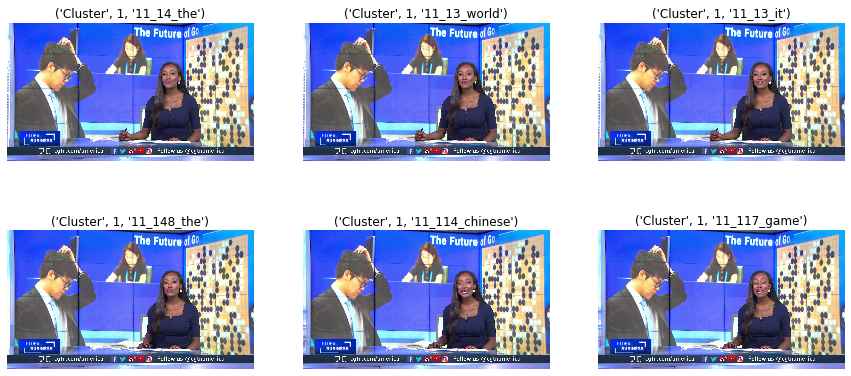

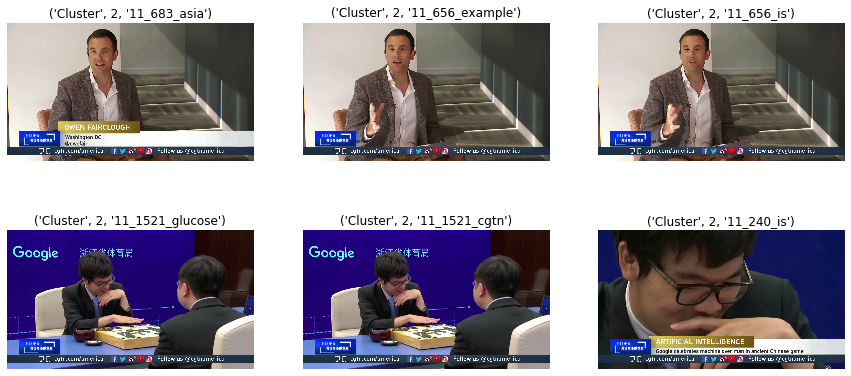

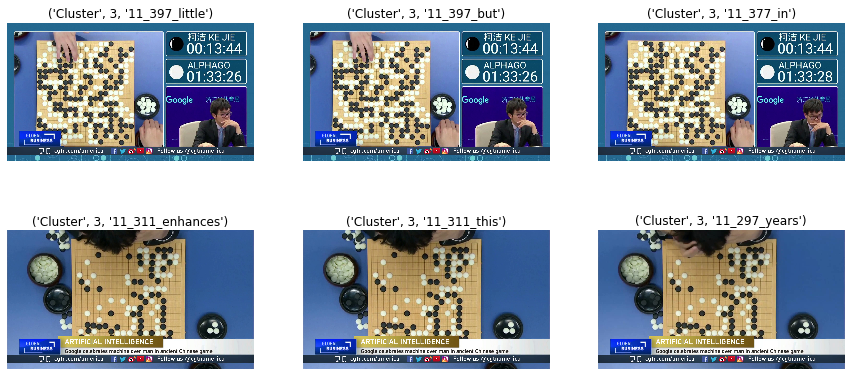

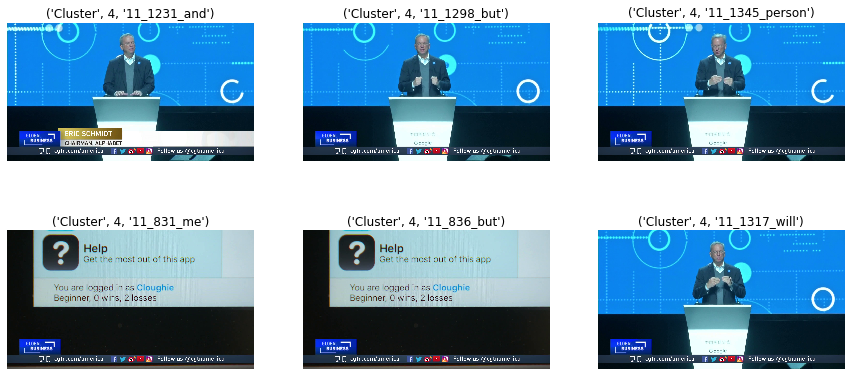

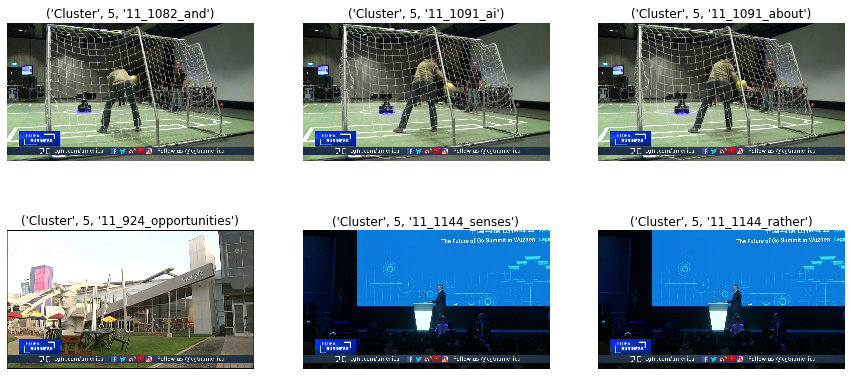

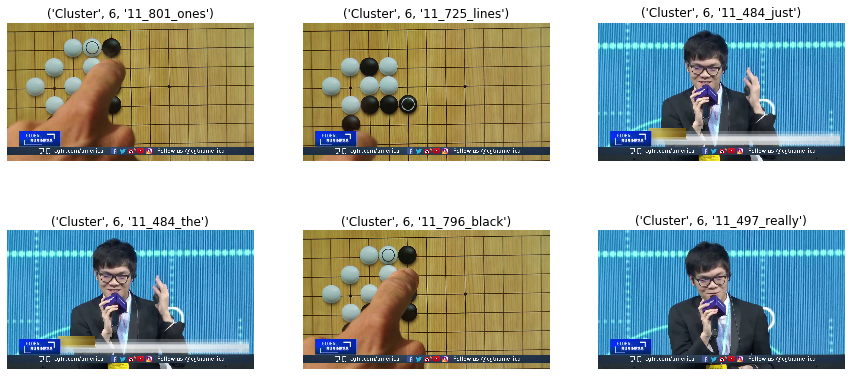

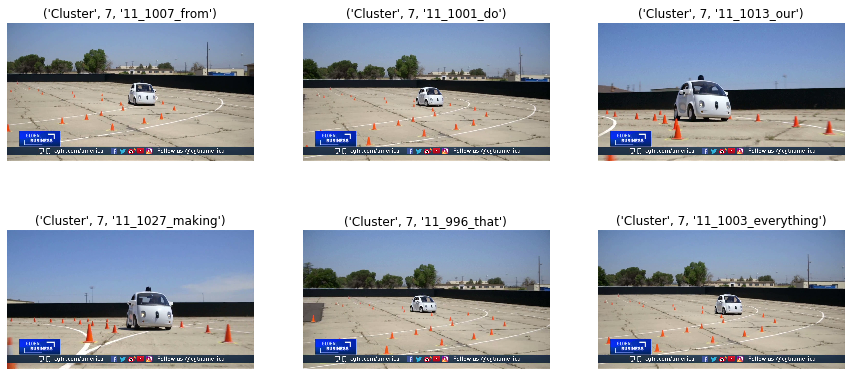

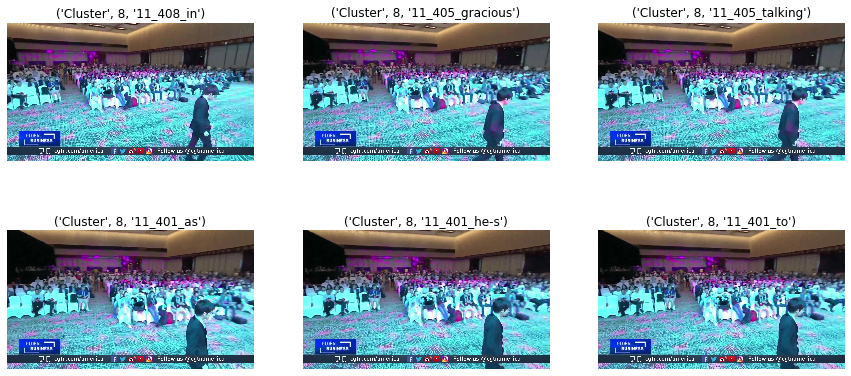

<Figure size 1080x504 with 0 Axes>

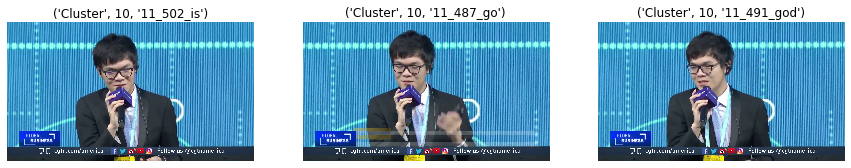

<Figure size 1080x504 with 0 Axes>

In [87]:
%pylab inline

filePath_11 = '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames'
print_cluster_image(filePath_11, cluster_dict_11, cluster_num_11)

### Video 19

In [91]:
cluster_num_19 = PCA_cluster_num(df2_19)
clustering_df_19 = Seq_NMF(cluster_num_19, df2_19, print_cluster = True)

0 th eigenvalue is:  20.523171280179664
1 th eigenvalue is:  11.29078979116786
2 th eigenvalue is:  5.845947121584052
3 th eigenvalue is:  4.370823051423439
4 th eigenvalue is:  3.3058683891468155
5 th eigenvalue is:  3.0198968531342185
6 th eigenvalue is:  2.2767767091003894
7 th eigenvalue is:  1.9408638395048494
8 th eigenvalue is:  1.6801433988042391
9 th eigenvalue is:  1.356146365972263
10 th eigenvalue is:  1.0313314001020577
11 th eigenvalue is:  0.937135305778272
---------------------------------
Number of clusters:  11
Building components one by one...
	1 of 11
Current Chi2=0.0150, Previous Chi2=1.7855, Change=99.1607% @ niters=0
Took 0.004 minutes to reach current solution.
	2 of 11
Current Chi2=0.0194, Previous Chi2=0.1289, Change=84.9355% @ niters=0
Current Chi2=0.0156, Previous Chi2=0.0157, Change=0.2604% @ niters=20
Current Chi2=0.0152, Previous Chi2=0.0152, Change=0.0789% @ niters=40
Current Chi2=0.0150, Previous Chi2=0.0150, Change=0.0562% @ niters=60
Current Chi2=0.01

Current Chi2=0.0063, Previous Chi2=0.0063, Change=0.0089% @ niters=600
Current Chi2=0.0063, Previous Chi2=0.0063, Change=0.0078% @ niters=620
Current Chi2=0.0063, Previous Chi2=0.0063, Change=0.0069% @ niters=640
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0061% @ niters=660
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0055% @ niters=680
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0049% @ niters=700
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0044% @ niters=720
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0040% @ niters=740
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0037% @ niters=760
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0034% @ niters=780
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0031% @ niters=800
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0028% @ niters=820
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0025% @ niters=840
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0023% @ niters=860
Curren

Current Chi2=0.0052, Previous Chi2=0.0052, Change=0.7937% @ niters=20
Current Chi2=0.0047, Previous Chi2=0.0048, Change=0.2259% @ niters=40
Current Chi2=0.0046, Previous Chi2=0.0046, Change=0.1019% @ niters=60
Current Chi2=0.0045, Previous Chi2=0.0045, Change=0.0612% @ niters=80
Current Chi2=0.0045, Previous Chi2=0.0045, Change=0.0472% @ niters=100
Current Chi2=0.0044, Previous Chi2=0.0044, Change=0.0464% @ niters=120
Current Chi2=0.0044, Previous Chi2=0.0044, Change=0.0553% @ niters=140
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0733% @ niters=160
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0981% @ niters=180
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.1223% @ niters=200
Current Chi2=0.0041, Previous Chi2=0.0041, Change=0.1329% @ niters=220
Current Chi2=0.0040, Previous Chi2=0.0040, Change=0.1224% @ niters=240
Current Chi2=0.0039, Previous Chi2=0.0039, Change=0.0984% @ niters=260
Current Chi2=0.0038, Previous Chi2=0.0038, Change=0.0739% @ niters=280
Current Ch

Current Chi2=0.0029, Previous Chi2=0.0029, Change=0.0670% @ niters=380
Current Chi2=0.0029, Previous Chi2=0.0029, Change=0.0731% @ niters=400
Current Chi2=0.0028, Previous Chi2=0.0028, Change=0.0724% @ niters=420
Current Chi2=0.0028, Previous Chi2=0.0028, Change=0.0655% @ niters=440
Current Chi2=0.0027, Previous Chi2=0.0027, Change=0.0555% @ niters=460
Current Chi2=0.0027, Previous Chi2=0.0027, Change=0.0453% @ niters=480
Current Chi2=0.0027, Previous Chi2=0.0027, Change=0.0366% @ niters=500
Current Chi2=0.0027, Previous Chi2=0.0027, Change=0.0295% @ niters=520
Current Chi2=0.0027, Previous Chi2=0.0027, Change=0.0240% @ niters=540
Current Chi2=0.0027, Previous Chi2=0.0027, Change=0.0196% @ niters=560
Current Chi2=0.0026, Previous Chi2=0.0026, Change=0.0162% @ niters=580
Current Chi2=0.0026, Previous Chi2=0.0026, Change=0.0136% @ niters=600
Current Chi2=0.0026, Previous Chi2=0.0026, Change=0.0115% @ niters=620
Current Chi2=0.0026, Previous Chi2=0.0026, Change=0.0100% @ niters=640
Curren

Current Chi2=0.0021, Previous Chi2=0.0021, Change=0.0320% @ niters=640
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0302% @ niters=660
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0284% @ niters=680
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0266% @ niters=700
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0248% @ niters=720
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0231% @ niters=740
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0214% @ niters=760
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0199% @ niters=780
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0185% @ niters=800
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0171% @ niters=820
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0159% @ niters=840
Current Chi2=0.0020, Previous Chi2=0.0020, Change=0.0147% @ niters=860
Current Chi2=0.0019, Previous Chi2=0.0019, Change=0.0135% @ niters=880
Current Chi2=0.0019, Previous Chi2=0.0019, Change=0.0124% @ niters=900
Curren

In [92]:
print("For Video 19(Chinese), number of cluster is", cluster_num_19)

For Video 19(Chinese), number of cluster is 11


Populating the interactive namespace from numpy and matplotlib


{1: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_363_人.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_354_四.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_326_赛.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_350_下.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_359_对.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_353_第.png'],
 2: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_671_局.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_482_当.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames/19_980_是.

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 20154 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 20154 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 22235 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 22235 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 36187 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

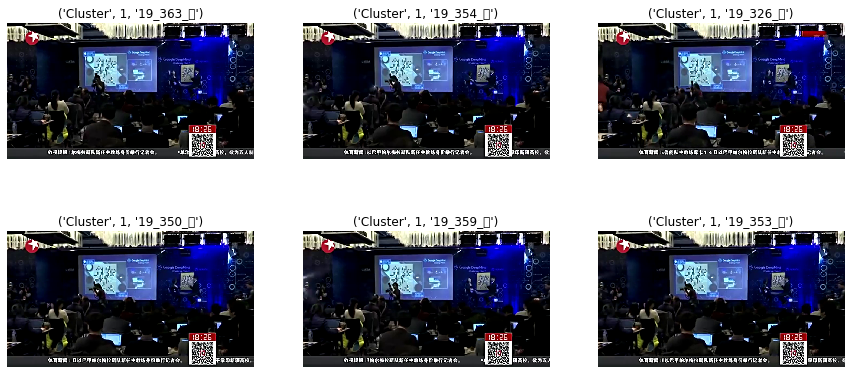

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 23616 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 23616 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 24403 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 24403 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26159 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

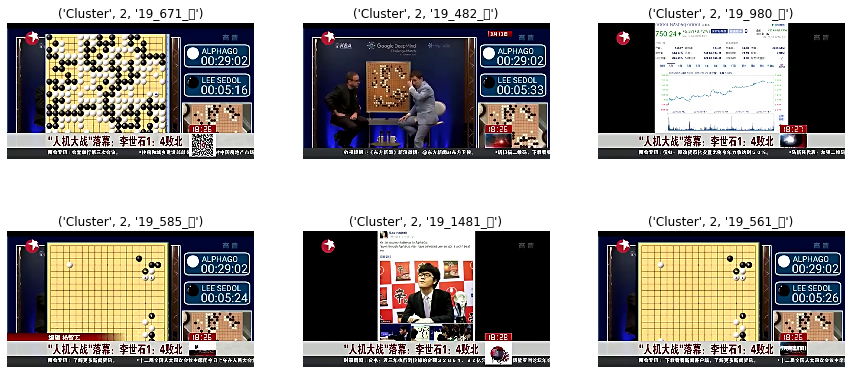

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 33021 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 33021 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 24231 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 24231 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 34920 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

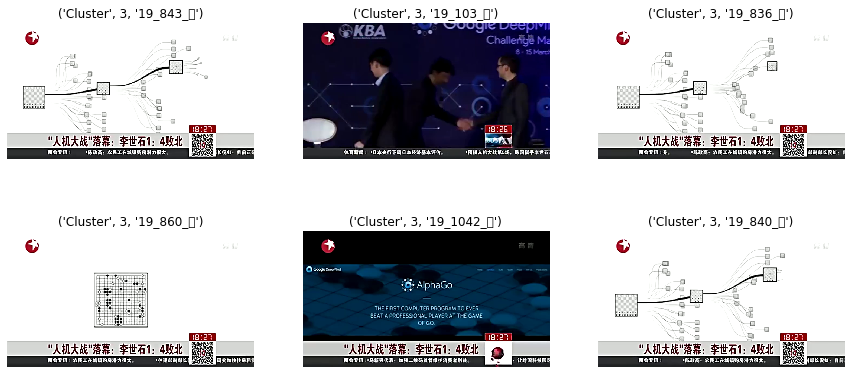

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 22269 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 22269 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 30340 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 30340 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27425 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

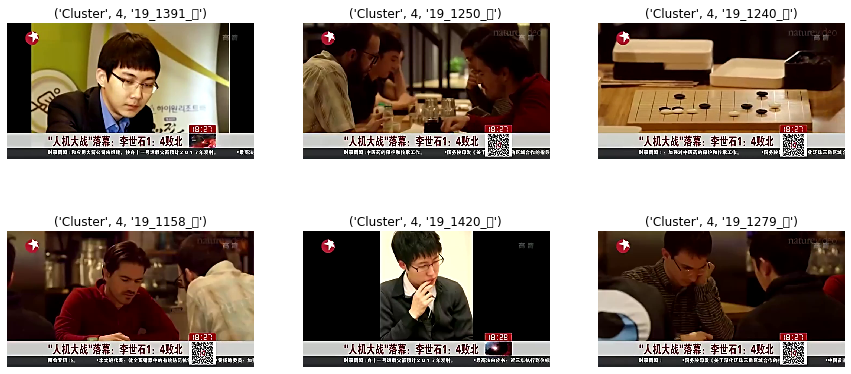

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 21464 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 21464 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 19996 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 19996 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27431 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

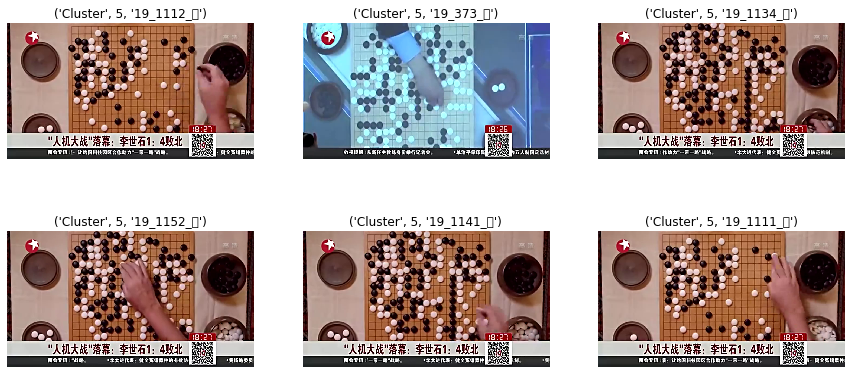

<Figure size 1080x504 with 0 Axes>

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 22823 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 22823 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 22312 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 22312 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26426 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

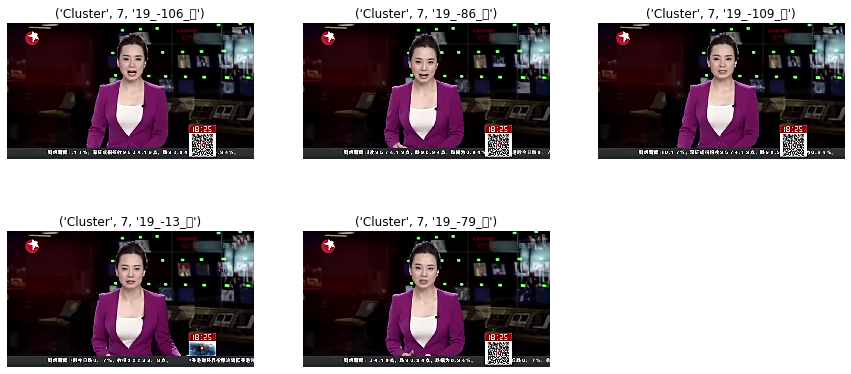

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

In [97]:
cluster_dict_19 = print_cluster(clustering_df_19, cluster_num_19, print_all= True, cluster_lst = None, print = False)
%pylab inline

filePath_19 = '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames'
print_cluster_image(filePath_19, cluster_dict_19, cluster_num_19)

### Video 67

In [98]:
cluster_num_67 = PCA_cluster_num(df2_67)
clustering_df_67 = Seq_NMF(cluster_num_67, df2_67, print_cluster = True)

0 th eigenvalue is:  12.98807015368731
1 th eigenvalue is:  10.50414907496895
2 th eigenvalue is:  6.838612283912648
3 th eigenvalue is:  5.968370960552408
4 th eigenvalue is:  4.46231740771743
5 th eigenvalue is:  3.6148869709777403
6 th eigenvalue is:  2.606487642060249
7 th eigenvalue is:  2.153328069406299
8 th eigenvalue is:  1.975229130876051
9 th eigenvalue is:  1.6068632583368307
10 th eigenvalue is:  1.3694274073021195
11 th eigenvalue is:  1.0516691251188592
12 th eigenvalue is:  0.9025598236645851
---------------------------------
Number of clusters:  12
Building components one by one...
	1 of 12
Current Chi2=0.0157, Previous Chi2=1.7700, Change=99.1142% @ niters=0
Took 0.006 minutes to reach current solution.
	2 of 12
Current Chi2=0.0200, Previous Chi2=0.1282, Change=84.3665% @ niters=0
Current Chi2=0.0163, Previous Chi2=0.0164, Change=0.2403% @ niters=20
Current Chi2=0.0159, Previous Chi2=0.0159, Change=0.0680% @ niters=40
Current Chi2=0.0158, Previous Chi2=0.0158, Change=

Current Chi2=0.0087, Previous Chi2=0.0087, Change=0.0105% @ niters=380
Current Chi2=0.0087, Previous Chi2=0.0087, Change=0.0086% @ niters=400
Current Chi2=0.0087, Previous Chi2=0.0087, Change=0.0072% @ niters=420
Current Chi2=0.0087, Previous Chi2=0.0087, Change=0.0061% @ niters=440
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0051% @ niters=460
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0043% @ niters=480
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0038% @ niters=500
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0034% @ niters=520
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0031% @ niters=540
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0029% @ niters=560
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0028% @ niters=580
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0026% @ niters=600
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0025% @ niters=620
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0023% @ niters=640
Curren

Current Chi2=0.0068, Previous Chi2=0.0069, Change=0.5878% @ niters=20
Current Chi2=0.0064, Previous Chi2=0.0064, Change=0.1629% @ niters=40
Current Chi2=0.0063, Previous Chi2=0.0063, Change=0.0719% @ niters=60
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0414% @ niters=80
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0296% @ niters=100
Current Chi2=0.0061, Previous Chi2=0.0061, Change=0.0263% @ niters=120
Current Chi2=0.0061, Previous Chi2=0.0061, Change=0.0287% @ niters=140
Current Chi2=0.0061, Previous Chi2=0.0061, Change=0.0366% @ niters=160
Current Chi2=0.0060, Previous Chi2=0.0060, Change=0.0500% @ niters=180
Current Chi2=0.0059, Previous Chi2=0.0059, Change=0.0676% @ niters=200
Current Chi2=0.0059, Previous Chi2=0.0059, Change=0.0836% @ niters=220
Current Chi2=0.0057, Previous Chi2=0.0058, Change=0.0896% @ niters=240
Current Chi2=0.0056, Previous Chi2=0.0057, Change=0.0824% @ niters=260
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0682% @ niters=280
Current Ch

Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0198% @ niters=460
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0158% @ niters=480
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0127% @ niters=500
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0103% @ niters=520
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0084% @ niters=540
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0070% @ niters=560
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0059% @ niters=580
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0050% @ niters=600
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0042% @ niters=620
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0036% @ niters=640
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0032% @ niters=660
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0028% @ niters=680
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0024% @ niters=700
Current Chi2=0.0041, Previous Chi2=0.0041, Change=0.0022% @ niters=720
Curren

Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0027% @ niters=820
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0025% @ niters=840
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0023% @ niters=860
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0021% @ niters=880
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0020% @ niters=900
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0018% @ niters=920
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0017% @ niters=940
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0016% @ niters=960
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0015% @ niters=980
Iteration in re-initialization reaches maximum number = 1000
Took 1.460 minutes to reach current solution.
	12 of 12
Current Chi2=0.0078, Previous Chi2=0.1206, Change=93.5502% @ niters=0
Current Chi2=0.0040, Previous Chi2=0.0040, Change=1.0105% @ niters=20
Current Chi2=0.0036, Previous Chi2=0.0036, Change=0.2929% @ niters=40
Current Chi2=0.0035, Previous Chi2

In [127]:
print("For Video 67(Chinese), number of cluster is", cluster_num_67)

For Video 67(Chinese), number of cluster is 12


Populating the interactive namespace from numpy and matplotlib


{1: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_-36_棋.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_-31_冠.png'],
 2: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_1394_局.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_1328_的.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_609_damage.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_1602_是.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_73_月.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_661_impress.png'],
 3: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-An

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 20896 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 20896 missing from current font.
  font.set_text(s, 0, flags=flags)


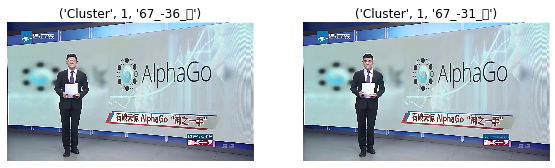

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 23616 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 23616 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26376 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 26376 missing from current font.
  font.set_text(s, 0, flags=flags)


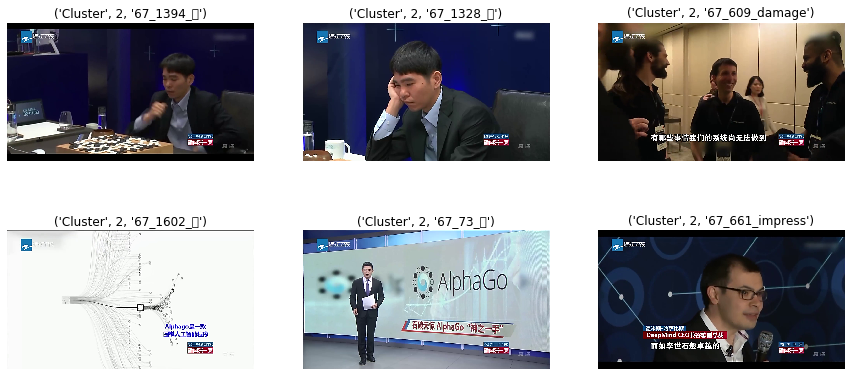

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26469 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 26469 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 19981 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 19981 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26032 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

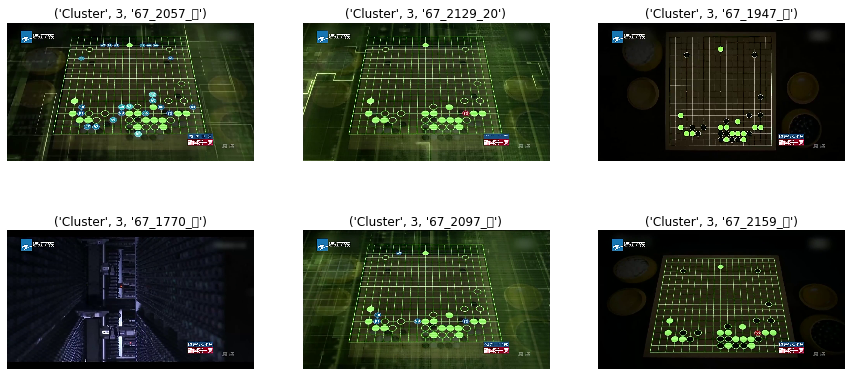

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 24212 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 24212 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27809 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 27809 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 20154 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

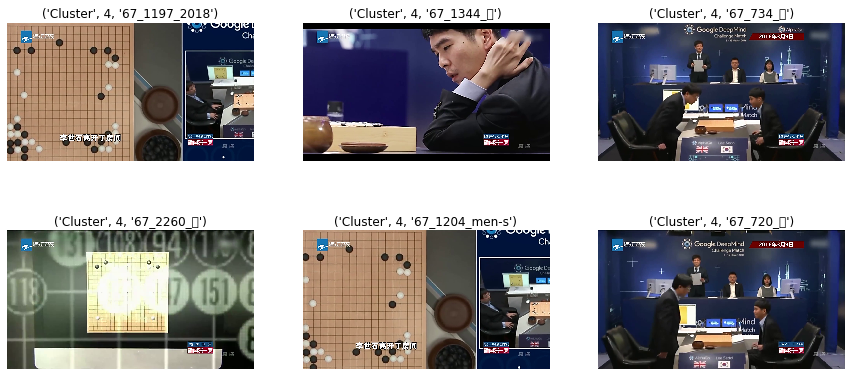

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31034 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 31034 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 20309 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 20309 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 24935 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

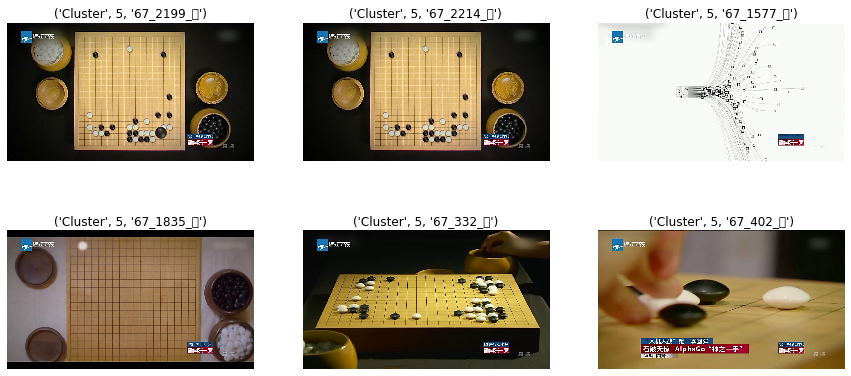

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 38376 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 38376 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 21313 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 21313 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 38215 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

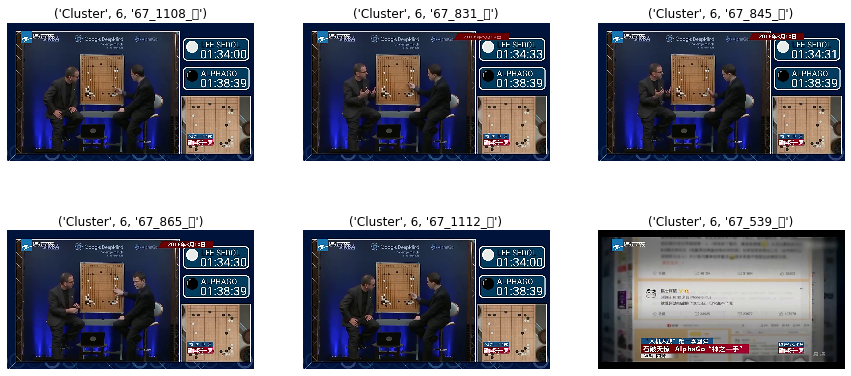

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26426 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 26426 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 22937 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 22937 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 33021 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

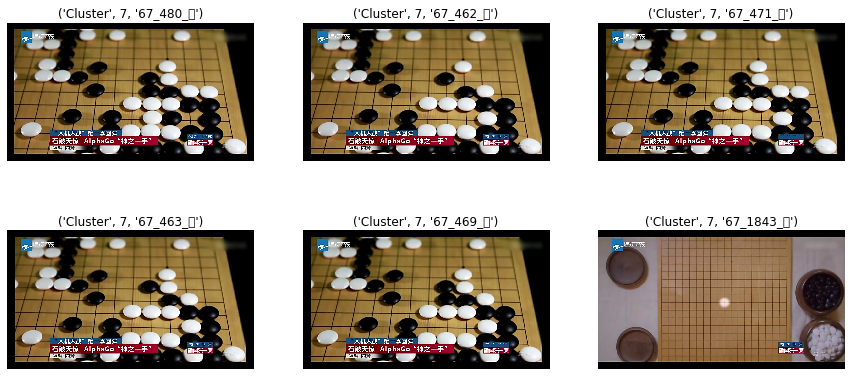

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 24037 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 24037 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 22235 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 22235 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27604 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

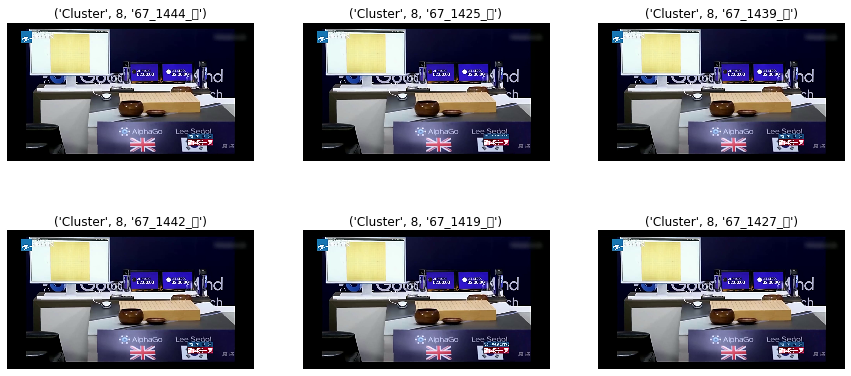

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

In [128]:
cluster_dict_67 = print_cluster(clustering_df_67, cluster_num_67, print_all= True, cluster_lst = None, print = False)
%pylab inline

filePath_67 = '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old'
print_cluster_image(filePath_67, cluster_dict_67, cluster_num_67)

## Analyze videos from same culture 

In [101]:
cluster_num_8_11 = PCA_cluster_num(df_8_11)
clustering_df_8_11 = Seq_NMF(cluster_num_8_11, df_8_11)

0 th eigenvalue is:  22.209696029531894
1 th eigenvalue is:  8.982871482736353
2 th eigenvalue is:  6.221934360400461
3 th eigenvalue is:  4.7803985772376425
4 th eigenvalue is:  3.4179773661190955
5 th eigenvalue is:  2.6773867826846844
6 th eigenvalue is:  2.3975127681274424
7 th eigenvalue is:  1.984806954724733
8 th eigenvalue is:  1.531026061323384
9 th eigenvalue is:  1.3529549213513858
10 th eigenvalue is:  1.2120065656707393
11 th eigenvalue is:  1.0394432660891701
12 th eigenvalue is:  0.9102428391150899
---------------------------------
Number of clusters:  12
Building components one by one...
	1 of 12
Current Chi2=0.0165, Previous Chi2=1.7085, Change=99.0319% @ niters=0
Took 0.011 minutes to reach current solution.
	2 of 12
Current Chi2=0.0209, Previous Chi2=0.1260, Change=83.3979% @ niters=0
Current Chi2=0.0172, Previous Chi2=0.0172, Change=0.2307% @ niters=20
Current Chi2=0.0167, Previous Chi2=0.0168, Change=0.0933% @ niters=40
Current Chi2=0.0163, Previous Chi2=0.0164, Ch

Current Chi2=0.0078, Previous Chi2=0.0078, Change=0.0215% @ niters=180
Current Chi2=0.0078, Previous Chi2=0.0078, Change=0.0300% @ niters=200
Current Chi2=0.0077, Previous Chi2=0.0077, Change=0.0431% @ niters=220
Current Chi2=0.0076, Previous Chi2=0.0076, Change=0.0596% @ niters=240
Current Chi2=0.0075, Previous Chi2=0.0075, Change=0.0752% @ niters=260
Current Chi2=0.0074, Previous Chi2=0.0074, Change=0.0833% @ niters=280
Current Chi2=0.0073, Previous Chi2=0.0073, Change=0.0819% @ niters=300
Current Chi2=0.0072, Previous Chi2=0.0072, Change=0.0740% @ niters=320
Current Chi2=0.0071, Previous Chi2=0.0071, Change=0.0636% @ niters=340
Current Chi2=0.0070, Previous Chi2=0.0070, Change=0.0527% @ niters=360
Current Chi2=0.0069, Previous Chi2=0.0069, Change=0.0424% @ niters=380
Current Chi2=0.0069, Previous Chi2=0.0069, Change=0.0333% @ niters=400
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0258% @ niters=420
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0199% @ niters=440
Curren

Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0059% @ niters=640
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0054% @ niters=660
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0050% @ niters=680
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0046% @ niters=700
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0042% @ niters=720
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0039% @ niters=740
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0037% @ niters=760
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0035% @ niters=780
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0033% @ niters=800
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0031% @ niters=820
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0030% @ niters=840
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0029% @ niters=860
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0028% @ niters=880
Current Chi2=0.0054, Previous Chi2=0.0054, Change=0.0027% @ niters=900
Curren

Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0021% @ niters=900
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0019% @ niters=920
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0018% @ niters=940
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0017% @ niters=960
Current Chi2=0.0042, Previous Chi2=0.0042, Change=0.0015% @ niters=980
Iteration in re-initialization reaches maximum number = 1000
Took 2.319 minutes to reach current solution.
	10 of 12
Current Chi2=0.0087, Previous Chi2=0.1184, Change=92.6314% @ niters=0
Current Chi2=0.0049, Previous Chi2=0.0049, Change=0.7948% @ niters=20
Current Chi2=0.0045, Previous Chi2=0.0045, Change=0.2227% @ niters=40
Current Chi2=0.0044, Previous Chi2=0.0044, Change=0.0960% @ niters=60
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0522% @ niters=80
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0330% @ niters=100
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0234% @ niters=120
Current Chi2=0.0043, Previous Chi2=0

Current Chi2=0.0034, Previous Chi2=0.0034, Change=0.0261% @ niters=320
Current Chi2=0.0034, Previous Chi2=0.0034, Change=0.0278% @ niters=340
Current Chi2=0.0034, Previous Chi2=0.0034, Change=0.0285% @ niters=360
Current Chi2=0.0034, Previous Chi2=0.0034, Change=0.0281% @ niters=380
Current Chi2=0.0034, Previous Chi2=0.0034, Change=0.0266% @ niters=400
Current Chi2=0.0034, Previous Chi2=0.0034, Change=0.0244% @ niters=420
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0219% @ niters=440
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0192% @ niters=460
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0167% @ niters=480
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0144% @ niters=500
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0124% @ niters=520
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0107% @ niters=540
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0092% @ niters=560
Current Chi2=0.0033, Previous Chi2=0.0033, Change=0.0079% @ niters=580
Curren

In [102]:
print("For Video 8 and 11(English), number of cluster is", cluster_num_8_11)

For Video 8 and 11(English), number of cluster is 12


Populating the interactive namespace from numpy and matplotlib


{1: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_1356_the.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_4683_that.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_4857_human.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_2158_so.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_1447_should.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_1381_do.png'],
 2: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/8_137_even.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames/11_148_the.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/engl

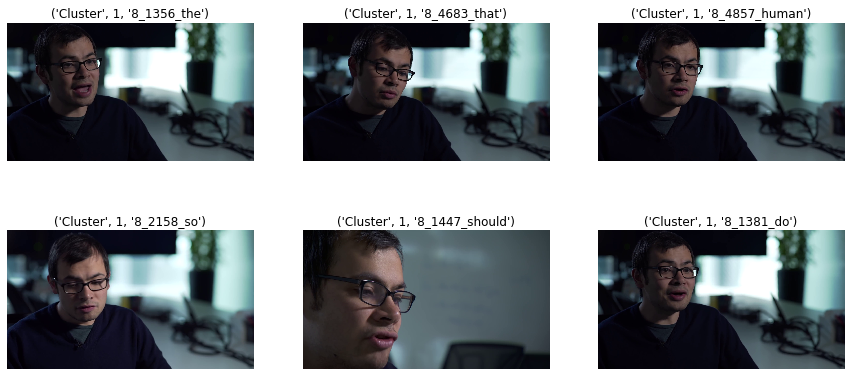

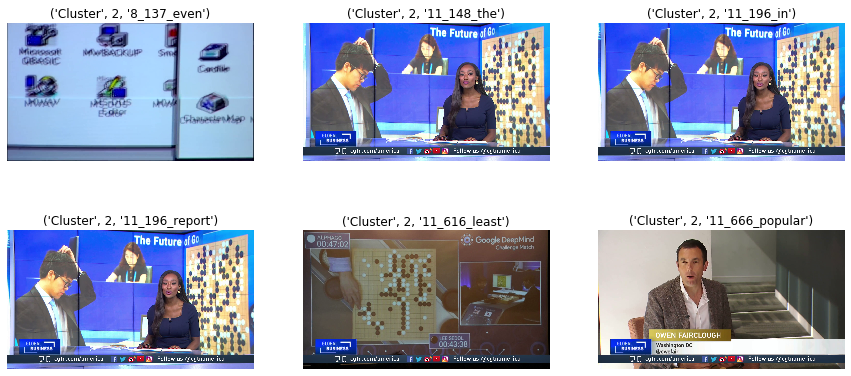

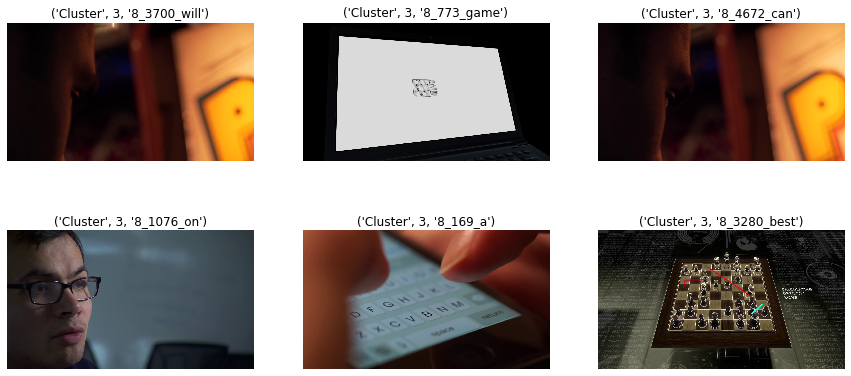

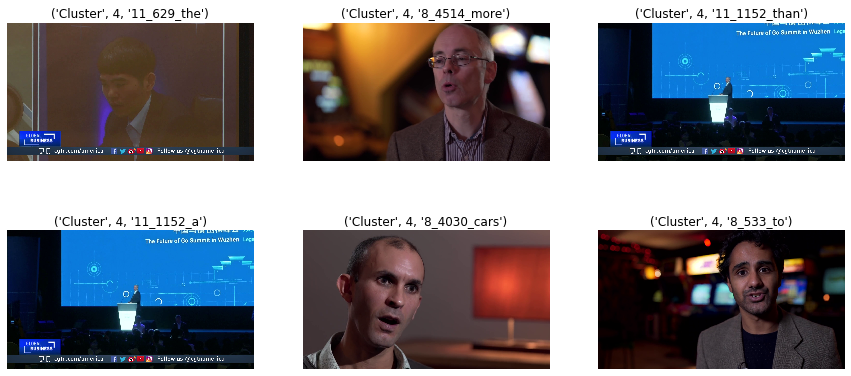

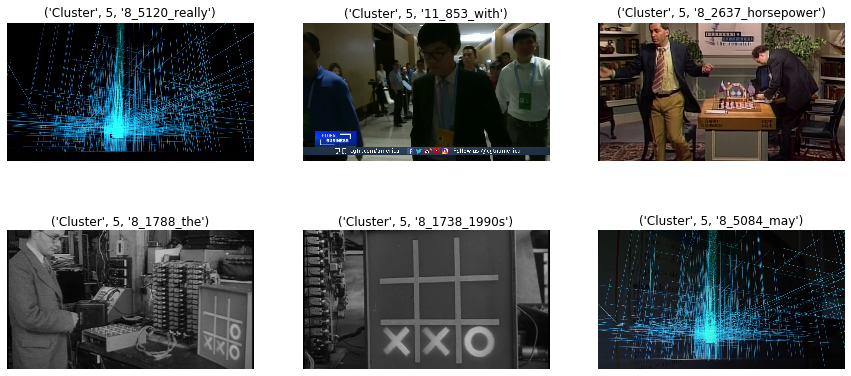

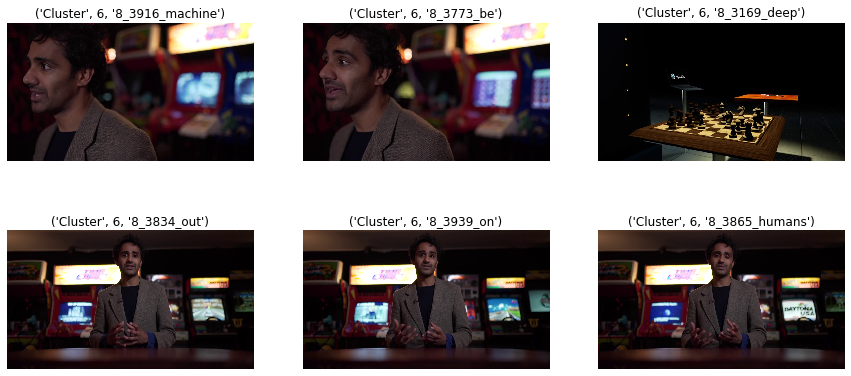

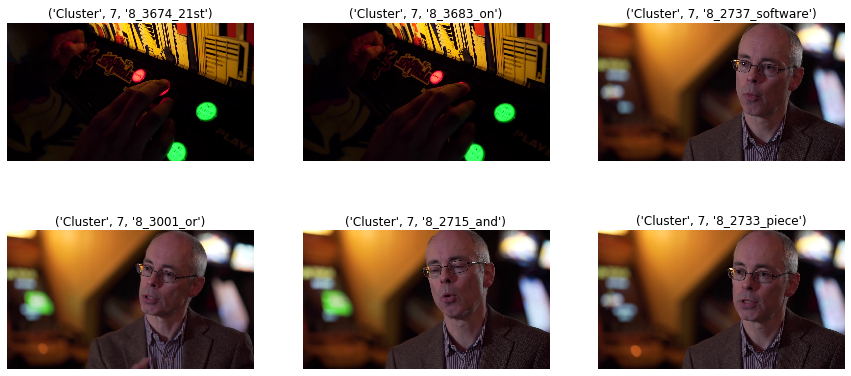

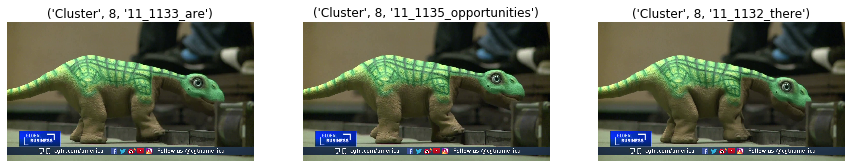

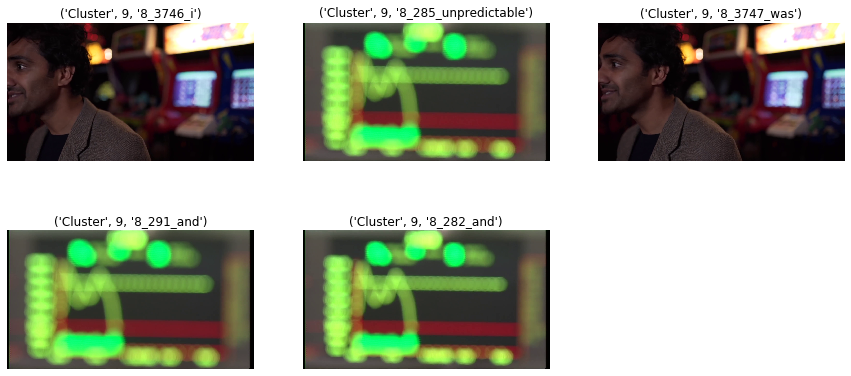

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

In [104]:
cluster_dict_8_11 = print_cluster(clustering_df_8_11, cluster_num_8_11, print_all= True, cluster_lst = None, print = False)
%pylab inline

filePath_8_11 = '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames'
print_cluster_image(filePath_8_11, cluster_dict_8_11, cluster_num_8_11)

## Chinese Videos

In [124]:
cluster_num_19_67 = PCA_cluster_num(df_19_67)
clustering_df_19_67 = Seq_NMF(cluster_num_19_67, df_19_67)

0 th eigenvalue is:  17.397879382821404
1 th eigenvalue is:  9.083984109012066
2 th eigenvalue is:  6.773265700912794
3 th eigenvalue is:  4.888913096873293
4 th eigenvalue is:  4.017168455934799
5 th eigenvalue is:  3.284483535555759
6 th eigenvalue is:  2.9227896125048893
7 th eigenvalue is:  2.162854933085299
8 th eigenvalue is:  1.9892566305354322
9 th eigenvalue is:  1.6446708582324163
10 th eigenvalue is:  1.526244037483628
11 th eigenvalue is:  1.2385199284453705
12 th eigenvalue is:  1.1794035981106892
13 th eigenvalue is:  0.9712490712559239
---------------------------------
Number of clusters:  13
Building components one by one...
	1 of 13
Current Chi2=0.0166, Previous Chi2=1.7768, Change=99.0630% @ niters=0
Took 0.011 minutes to reach current solution.
	2 of 13
Current Chi2=0.0211, Previous Chi2=0.1295, Change=83.6897% @ niters=0
Current Chi2=0.0173, Previous Chi2=0.0174, Change=0.2312% @ niters=20
Current Chi2=0.0169, Previous Chi2=0.0169, Change=0.0667% @ niters=40
Current

Current Chi2=0.0088, Previous Chi2=0.0088, Change=0.0166% @ niters=140
Current Chi2=0.0088, Previous Chi2=0.0088, Change=0.0209% @ niters=160
Current Chi2=0.0087, Previous Chi2=0.0087, Change=0.0293% @ niters=180
Current Chi2=0.0087, Previous Chi2=0.0087, Change=0.0424% @ niters=200
Current Chi2=0.0086, Previous Chi2=0.0086, Change=0.0584% @ niters=220
Current Chi2=0.0085, Previous Chi2=0.0085, Change=0.0717% @ niters=240
Current Chi2=0.0084, Previous Chi2=0.0084, Change=0.0750% @ niters=260
Current Chi2=0.0082, Previous Chi2=0.0082, Change=0.0674% @ niters=280
Current Chi2=0.0081, Previous Chi2=0.0081, Change=0.0546% @ niters=300
Current Chi2=0.0081, Previous Chi2=0.0081, Change=0.0422% @ niters=320
Current Chi2=0.0080, Previous Chi2=0.0080, Change=0.0325% @ niters=340
Current Chi2=0.0079, Previous Chi2=0.0080, Change=0.0255% @ niters=360
Current Chi2=0.0079, Previous Chi2=0.0079, Change=0.0205% @ niters=380
Current Chi2=0.0079, Previous Chi2=0.0079, Change=0.0167% @ niters=400
Curren

Current Chi2=0.0061, Previous Chi2=0.0061, Change=0.0014% @ niters=700
Current Chi2=0.0060, Previous Chi2=0.0060, Change=0.0013% @ niters=720
Current Chi2=0.0060, Previous Chi2=0.0060, Change=0.0012% @ niters=740
Current Chi2=0.0060, Previous Chi2=0.0060, Change=0.0012% @ niters=760
Current Chi2=0.0060, Previous Chi2=0.0060, Change=0.0011% @ niters=780
Current Chi2=0.0060, Previous Chi2=0.0060, Change=0.0011% @ niters=800
Current Chi2=0.0060, Previous Chi2=0.0060, Change=0.0010% @ niters=820
Took 2.094 minutes to reach current solution.
	8 of 13
Current Chi2=0.0106, Previous Chi2=0.1169, Change=90.9114% @ niters=0
Current Chi2=0.0067, Previous Chi2=0.0068, Change=0.5865% @ niters=20
Current Chi2=0.0063, Previous Chi2=0.0064, Change=0.1606% @ niters=40
Current Chi2=0.0062, Previous Chi2=0.0062, Change=0.0702% @ niters=60
Current Chi2=0.0061, Previous Chi2=0.0061, Change=0.0399% @ niters=80
Current Chi2=0.0061, Previous Chi2=0.0061, Change=0.0278% @ niters=100
Current Chi2=0.0061, Previo

Current Chi2=0.0046, Previous Chi2=0.0046, Change=0.0486% @ niters=340
Current Chi2=0.0045, Previous Chi2=0.0045, Change=0.0465% @ niters=360
Current Chi2=0.0045, Previous Chi2=0.0045, Change=0.0416% @ niters=380
Current Chi2=0.0044, Previous Chi2=0.0045, Change=0.0356% @ niters=400
Current Chi2=0.0044, Previous Chi2=0.0044, Change=0.0296% @ niters=420
Current Chi2=0.0044, Previous Chi2=0.0044, Change=0.0243% @ niters=440
Current Chi2=0.0044, Previous Chi2=0.0044, Change=0.0199% @ niters=460
Current Chi2=0.0044, Previous Chi2=0.0044, Change=0.0162% @ niters=480
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0132% @ niters=500
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0108% @ niters=520
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0089% @ niters=540
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0074% @ niters=560
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0061% @ niters=580
Current Chi2=0.0043, Previous Chi2=0.0043, Change=0.0050% @ niters=600
Curren

Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0080% @ niters=740
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0076% @ niters=760
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0072% @ niters=780
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0068% @ niters=800
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0065% @ niters=820
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0062% @ niters=840
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0060% @ niters=860
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0057% @ niters=880
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0055% @ niters=900
Current Chi2=0.0037, Previous Chi2=0.0037, Change=0.0053% @ niters=920
Current Chi2=0.0036, Previous Chi2=0.0036, Change=0.0051% @ niters=940
Current Chi2=0.0036, Previous Chi2=0.0036, Change=0.0049% @ niters=960
Current Chi2=0.0036, Previous Chi2=0.0036, Change=0.0047% @ niters=980
Iteration in re-initialization reaches maximum number = 1000
Took 2.661 minut

In [125]:
print("For Video 19 and 67(Chinese), number of cluster is", cluster_num_19_67)

For Video 19 and 67(Chinese), number of cluster is 13


Populating the interactive namespace from numpy and matplotlib


{1: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/19_636_乱.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/19_648_长.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/19_611_法.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/19_640_阵.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/19_632_有.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/19_1506_而.png'],
 2: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_425_合.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old/67_432_和.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 20081 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 20081 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 38271 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 38271 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27861 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

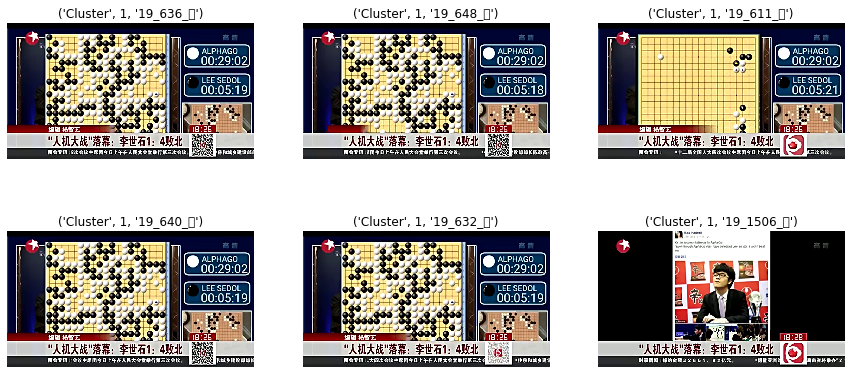

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 21512 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 21512 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 21644 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 21644 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 37096 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

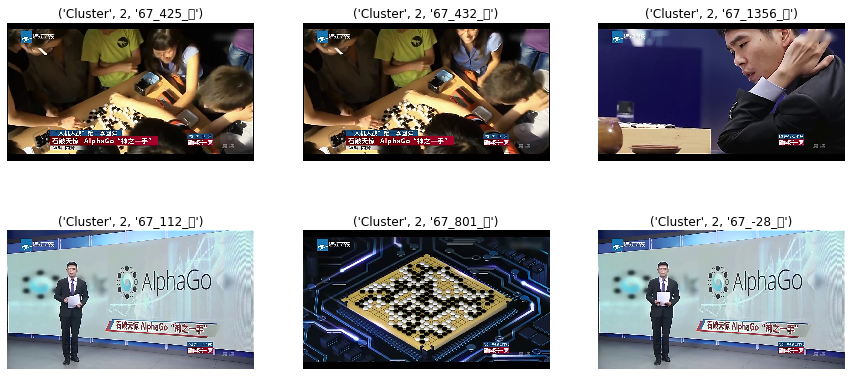

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 21517 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 21517 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 30340 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 30340 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27036 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

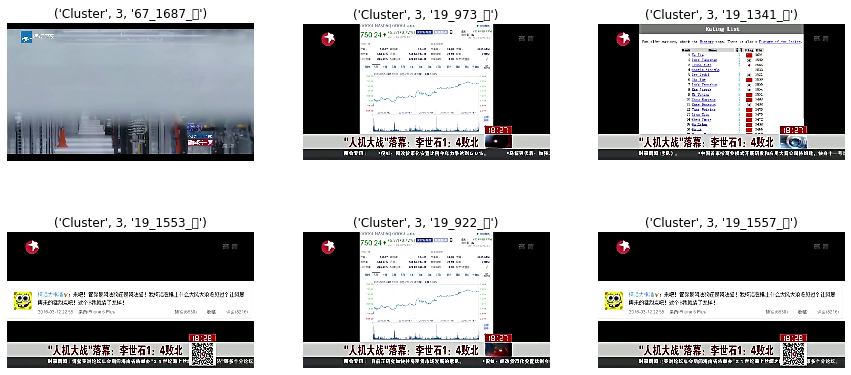

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31867 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 31867 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 22825 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 22825 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31070 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

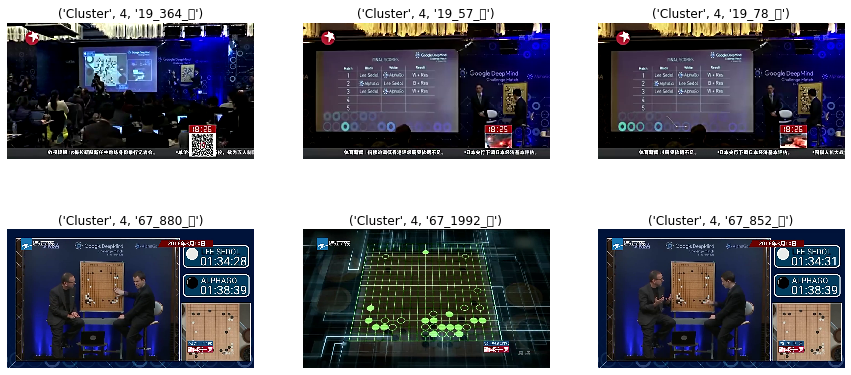

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26827 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 26827 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26472 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 26472 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 38388 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

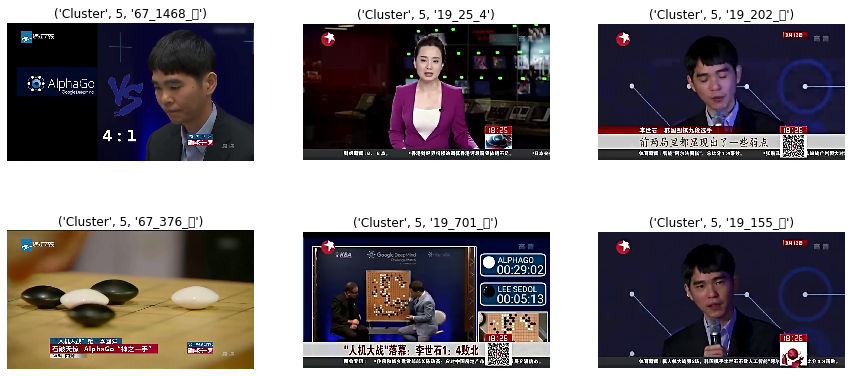

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 37327 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 37327 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 24590 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 24590 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26102 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

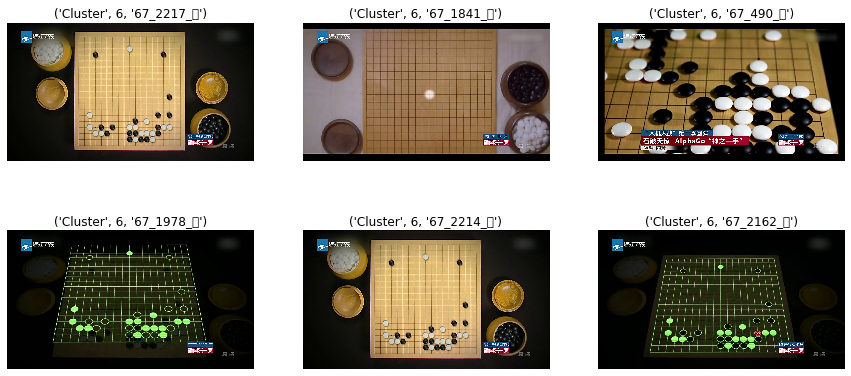

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 23665 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 23665 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 35029 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 35029 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 29399 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

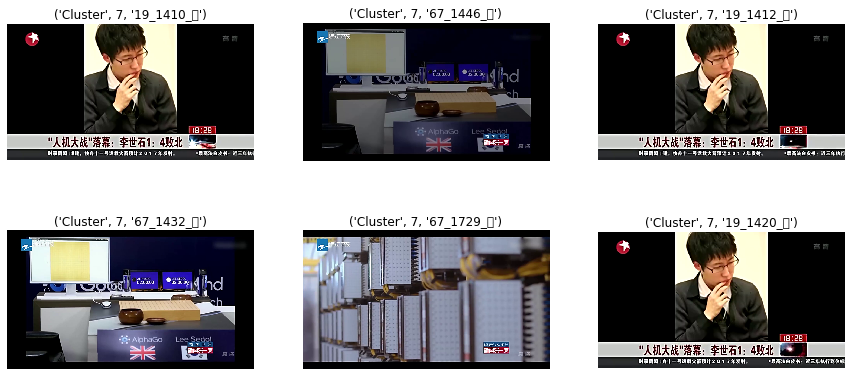

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 23545 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 23545 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 32463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 32463 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 21464 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

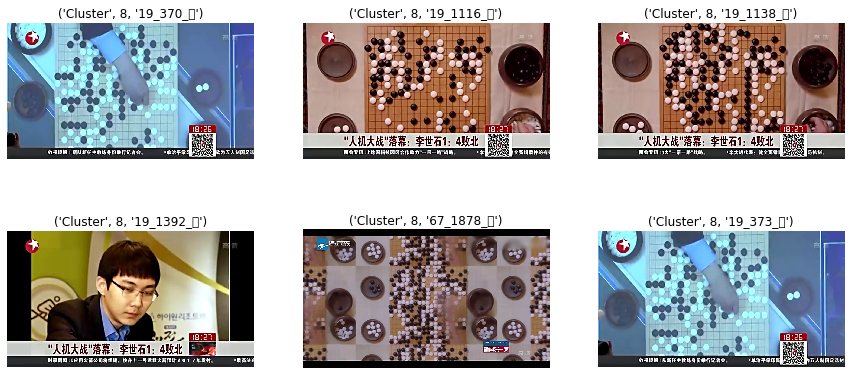

<Figure size 1080x504 with 0 Axes>

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 19968 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 19968 missing from current font.
  font.set_text(s, 0, flags=flags)


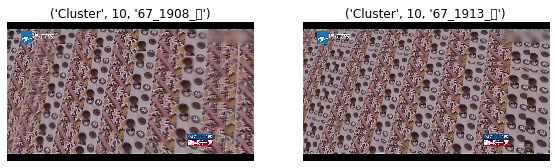

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

In [126]:
cluster_dict_19_67 = print_cluster(clustering_df_19_67, cluster_num_19_67, print_all= True, cluster_lst = None, print = False)
%pylab inline

filePath_19_67 = '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/chinese/frames_old'
print_cluster_image(filePath_19_67, cluster_dict_19_67, cluster_num_19_67)

### Four Videos together

In [130]:
cluster_num_all = PCA_cluster_num(df_all)
clustering_df_all = Seq_NMF(cluster_num_all, df_all)

0 th eigenvalue is:  24.243118044514517
1 th eigenvalue is:  8.73371187258712
2 th eigenvalue is:  7.9156708588281655
3 th eigenvalue is:  5.2463510279656855
4 th eigenvalue is:  3.386760084127113
5 th eigenvalue is:  3.123821416264178
6 th eigenvalue is:  2.475218905728779
7 th eigenvalue is:  2.351948041226475
8 th eigenvalue is:  1.9093023495949777
9 th eigenvalue is:  1.642822573972858
10 th eigenvalue is:  1.3359662901399876
11 th eigenvalue is:  1.1994442977209077
12 th eigenvalue is:  1.1316501008477418
13 th eigenvalue is:  0.931839138578658
---------------------------------
Number of clusters:  13
Building components one by one...
	1 of 13
Current Chi2=0.0188, Previous Chi2=1.7421, Change=98.9208% @ niters=0
Took 0.024 minutes to reach current solution.
	2 of 13
Current Chi2=0.0232, Previous Chi2=0.1306, Change=82.2222% @ niters=0
Current Chi2=0.0195, Previous Chi2=0.0195, Change=0.2030% @ niters=20
Current Chi2=0.0191, Previous Chi2=0.0191, Change=0.0651% @ niters=40
Current 

Current Chi2=0.0097, Previous Chi2=0.0097, Change=0.1072% @ niters=40
Current Chi2=0.0096, Previous Chi2=0.0096, Change=0.0485% @ niters=60
Current Chi2=0.0095, Previous Chi2=0.0095, Change=0.0296% @ niters=80
Current Chi2=0.0095, Previous Chi2=0.0095, Change=0.0235% @ niters=100
Current Chi2=0.0094, Previous Chi2=0.0094, Change=0.0235% @ niters=120
Current Chi2=0.0094, Previous Chi2=0.0094, Change=0.0277% @ niters=140
Current Chi2=0.0093, Previous Chi2=0.0093, Change=0.0350% @ niters=160
Current Chi2=0.0092, Previous Chi2=0.0092, Change=0.0436% @ niters=180
Current Chi2=0.0091, Previous Chi2=0.0091, Change=0.0502% @ niters=200
Current Chi2=0.0090, Previous Chi2=0.0091, Change=0.0512% @ niters=220
Current Chi2=0.0090, Previous Chi2=0.0090, Change=0.0464% @ niters=240
Current Chi2=0.0089, Previous Chi2=0.0089, Change=0.0385% @ niters=260
Current Chi2=0.0088, Previous Chi2=0.0088, Change=0.0305% @ niters=280
Current Chi2=0.0088, Previous Chi2=0.0088, Change=0.0240% @ niters=300
Current C

Current Chi2=0.0068, Previous Chi2=0.0069, Change=0.0108% @ niters=460
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0096% @ niters=480
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0087% @ niters=500
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0080% @ niters=520
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0074% @ niters=540
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0069% @ niters=560
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0065% @ niters=580
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0062% @ niters=600
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0059% @ niters=620
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0056% @ niters=640
Current Chi2=0.0068, Previous Chi2=0.0068, Change=0.0054% @ niters=660
Current Chi2=0.0067, Previous Chi2=0.0067, Change=0.0051% @ niters=680
Current Chi2=0.0067, Previous Chi2=0.0067, Change=0.0049% @ niters=700
Current Chi2=0.0067, Previous Chi2=0.0067, Change=0.0047% @ niters=720
Curren

Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0018% @ niters=720
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0018% @ niters=740
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0017% @ niters=760
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0017% @ niters=780
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0016% @ niters=800
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0016% @ niters=820
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0015% @ niters=840
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0015% @ niters=860
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0014% @ niters=880
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0014% @ niters=900
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0014% @ niters=920
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0014% @ niters=940
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0013% @ niters=960
Current Chi2=0.0056, Previous Chi2=0.0056, Change=0.0013% @ niters=980
Iterat

Current Chi2=0.0049, Previous Chi2=0.0049, Change=0.0883% @ niters=60
Current Chi2=0.0048, Previous Chi2=0.0048, Change=0.0485% @ niters=80
Current Chi2=0.0048, Previous Chi2=0.0048, Change=0.0310% @ niters=100
Current Chi2=0.0048, Previous Chi2=0.0048, Change=0.0220% @ niters=120
Current Chi2=0.0047, Previous Chi2=0.0047, Change=0.0171% @ niters=140
Current Chi2=0.0047, Previous Chi2=0.0047, Change=0.0144% @ niters=160
Current Chi2=0.0047, Previous Chi2=0.0047, Change=0.0130% @ niters=180
Current Chi2=0.0047, Previous Chi2=0.0047, Change=0.0125% @ niters=200
Current Chi2=0.0047, Previous Chi2=0.0047, Change=0.0128% @ niters=220
Current Chi2=0.0047, Previous Chi2=0.0047, Change=0.0138% @ niters=240
Current Chi2=0.0047, Previous Chi2=0.0047, Change=0.0154% @ niters=260
Current Chi2=0.0046, Previous Chi2=0.0046, Change=0.0176% @ niters=280
Current Chi2=0.0046, Previous Chi2=0.0046, Change=0.0201% @ niters=300
Current Chi2=0.0046, Previous Chi2=0.0046, Change=0.0227% @ niters=320
Current 

In [131]:
print("For all four videos, number of cluster is", cluster_num_all)

For all four videos, number of cluster is 13


Populating the interactive namespace from numpy and matplotlib


{1: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all/67_1177_of.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all/19_615_买.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all/19_1102_宝.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all/67_1215_room.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all/19_1132_自.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all/19_1134_东.png'],
 2: ['/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all/8_4718_can.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all/67_2383_待.png',
  '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysi

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 20080 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 20080 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 23453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 23453 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 33258 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

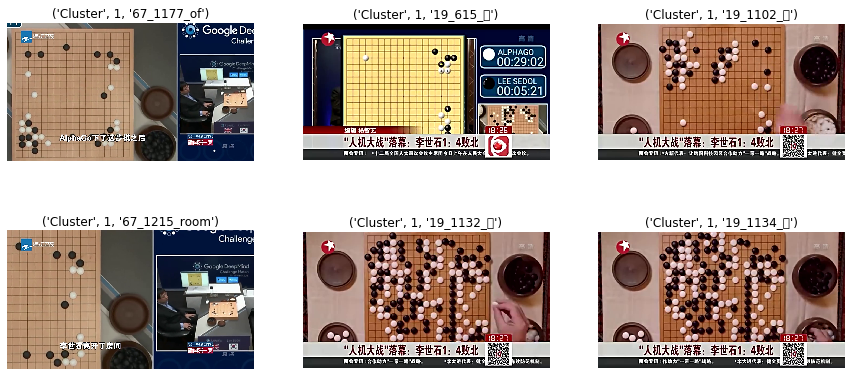

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 24453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 24453 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 30340 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 30340 missing from current font.
  font.set_text(s, 0, flags=flags)


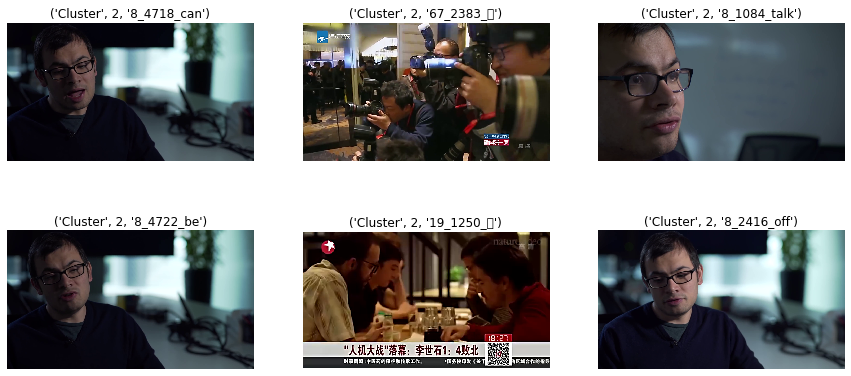

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 20154 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 20154 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 33853 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 33853 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 22235 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

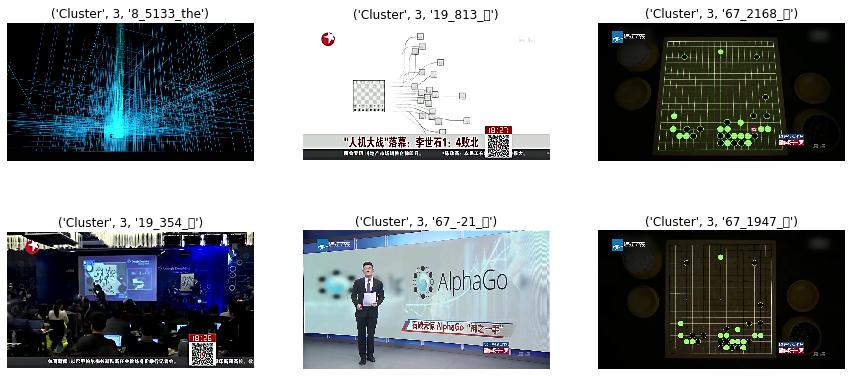

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27604 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 27604 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 21457 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 21457 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 36744 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

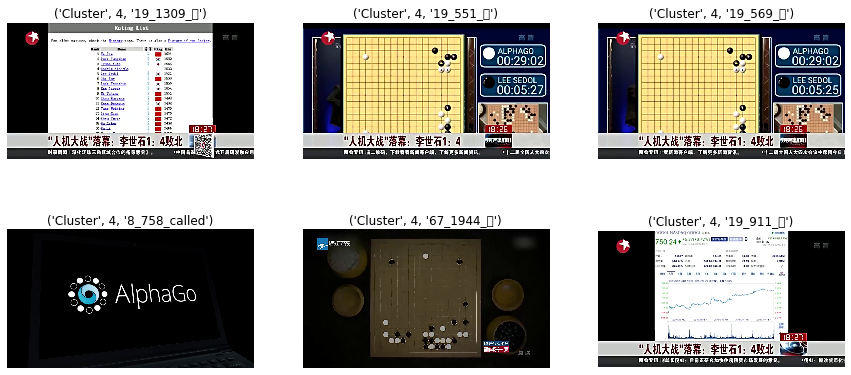

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 36824 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 36824 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 21516 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 21516 missing from current font.
  font.set_text(s, 0, flags=flags)


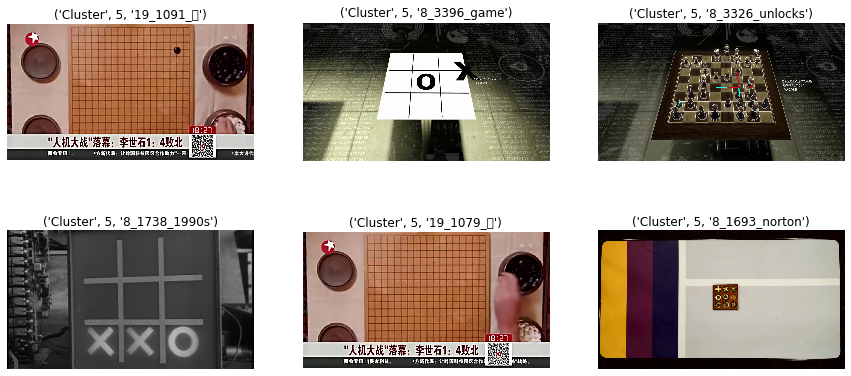

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31532 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 31532 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26420 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 26420 missing from current font.
  font.set_text(s, 0, flags=flags)


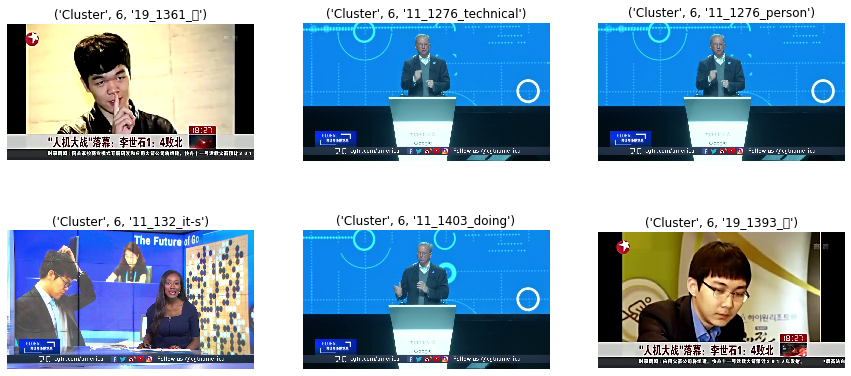

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27431 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 27431 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27178 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 27178 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 20026 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

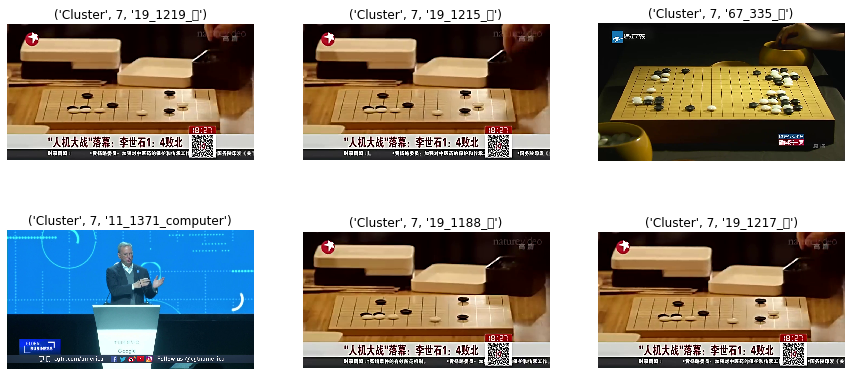

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31354 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 31354 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 29087 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 29087 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 36830 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/py

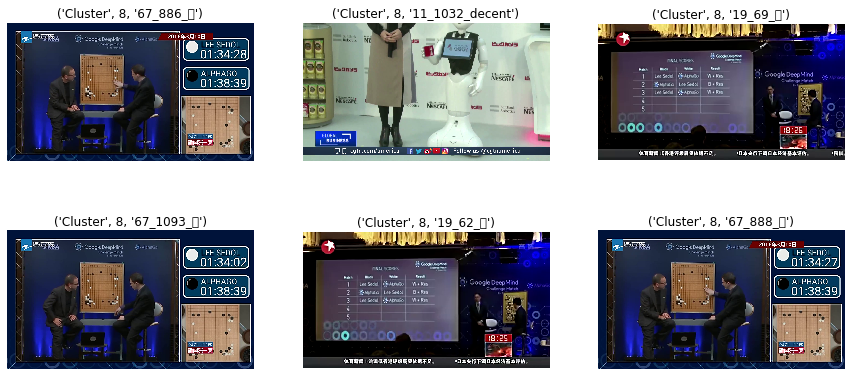

<Figure size 1080x504 with 0 Axes>

/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 27492 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 27492 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 19982 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/chenzhengyi/opt/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 19982 missing from current font.
  font.set_text(s, 0, flags=flags)


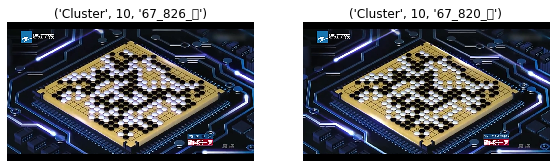

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

In [132]:
cluster_dict_all = print_cluster(clustering_df_all, cluster_num_all, print_all= True, cluster_lst = None, print = False)
%pylab inline

filePath_all = '/Users/chenzhengyi/Documents/GitHub/Cross-Cultural-Analysis-2/results/AlphaGo/english/frames_all'
print_cluster_image(filePath_all, cluster_dict_all, cluster_num_all)